# <center>Music Genre Classification</center>
<div>
   <center> 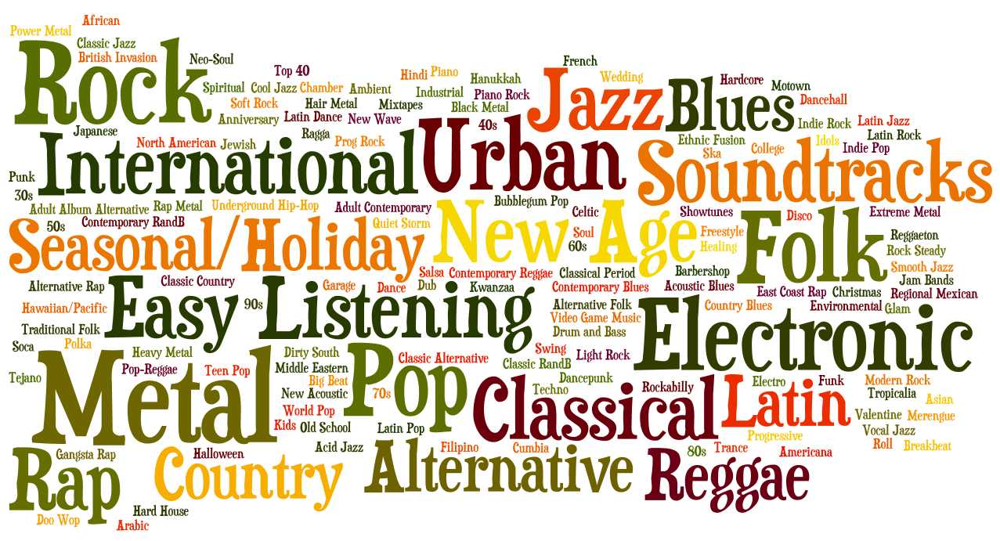</center>
</div>

<!-- 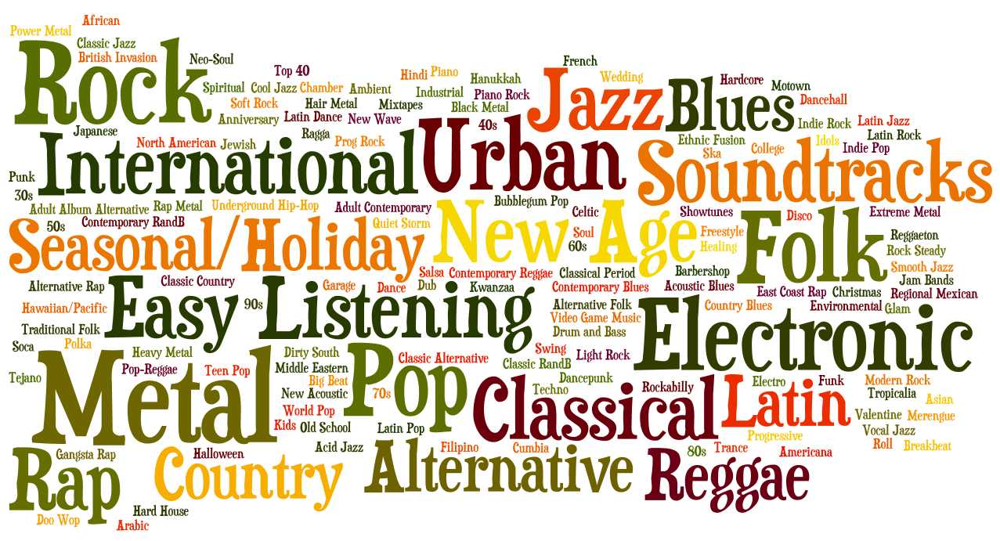 -->

Since the invention of portable players people have access to music anytime and anyplace. Now, people are using services like apple music, spotify etc to meet their music needs. As we are always exploring new music, we also discover new genres to gravitate towards. So here we work on predict the genre of music being playered, so the listen and explore more song using aforementioned music services

The data we are working in this competition are clip of non copy righted music with each clip being 30 secs long. It has music from 19 genres with 19909 files for training  and 5076 files for testing.

<div>
   <center> 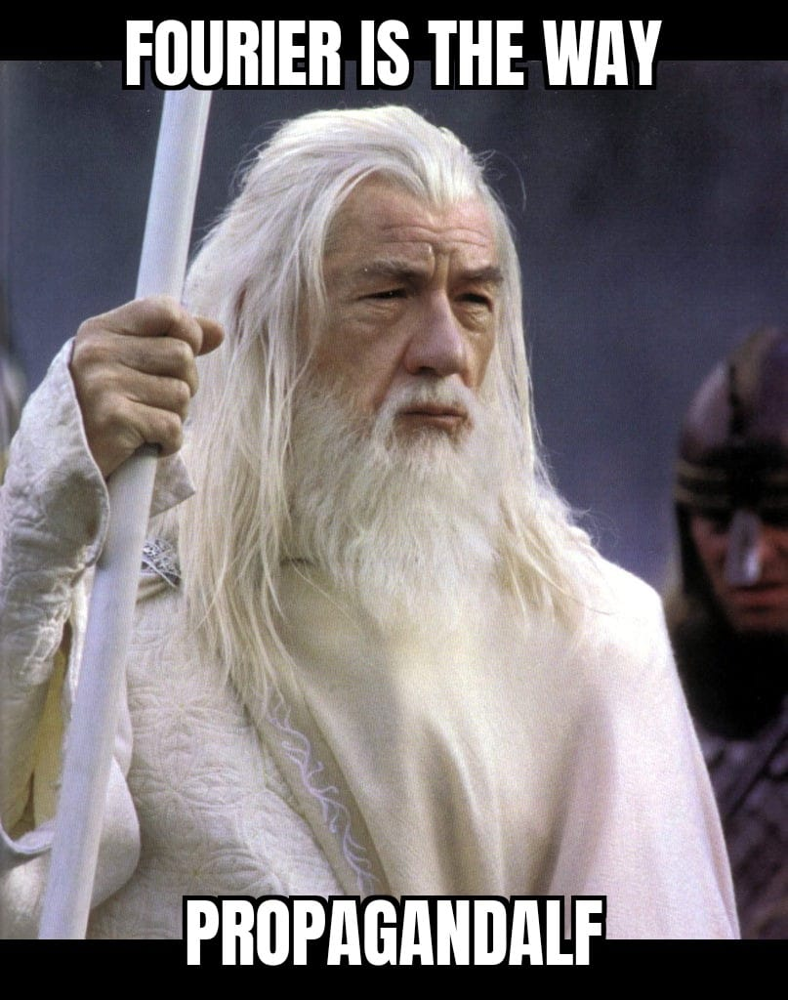</center>
</div>

Let's take a tour of the data visualization and model building.

### Contents
1. [Exploratory Data Analysis](#eda)
    * [Loading data](#loading)
    * [Sampling Audio Files](#audio)
    * [Visualisation of data](#viz)    
    * [Audio Length](#audio_length)


In [2]:
#importing relevant libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from datetime import datetime

from sklearn.model_selection import train_test_split
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
print(tf.__version__)
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout,Activation,Flatten
from tensorflow.keras.optimizers import Adam
from sklearn import metrics

import librosa
import librosa.display
import IPython.display as ipd

import os # you can also use import glob
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

from itertools import cycle

plt.style.use('fivethirtyeight')
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()["color"])

2.6.2


<a id="eda"></a>
## <center> Exploratory Data Analysis </center>

<a id="loading"></a>
### Loading and preparing relevant files

In [3]:
# create the list of all the files present in training folder

for dirname, _, filenames in os.walk('../input/kaggle-pog-series-s01e02/train'):
    paths = [os.path.join(dirname, filename) for filename in filenames]
    id = [filename.split('.')[0] for filename in filenames]
    
df_train = pd.DataFrame({'song_id':id})
df_train.song_id = df_train.song_id.astype(int)

In [4]:
train = pd.read_csv("../input/kaggle-pog-series-s01e02/train.csv")
test = pd.read_csv("../input/kaggle-pog-series-s01e02/test.csv")
sampleSub = pd.read_csv('../input/kaggle-pog-series-s01e02/sample_submission.csv')

In [5]:
print("The number of files as per train folder :", df_train.shape[0])
print("The number of files as per train csv :", train.shape[0])
train.head()

The number of files as per train folder : 19909
The number of files as per train csv : 19922


,song_id,filename,filepath,genre_id,genre
0,10150,010150.ogg,train/010150.ogg,7,Instrumental
1,7358,007358.ogg,train/007358.ogg,2,Punk
2,20573,020573.ogg,train/020573.ogg,5,Folk
3,11170,011170.ogg,train/011170.ogg,12,Old-Time / Historic
4,16662,016662.ogg,train/016662.ogg,1,Rock


As we can see the 13 files are missing, which is due to file corruption during  creation of dataset. The missing training dataset '003071.ogg', '003137.ogg', '004040.ogg', '009963.ogg', '011088.ogg', '013954.ogg', '015980.ogg', '016312.ogg', '017940.ogg', '022295.ogg', '022698.ogg', '023078.ogg', '024899.ogg' 

In [6]:
df= df_train.merge(train, on = 'song_id')
df.head()

,song_id,filename,filepath,genre_id,genre
0,11395,011395.ogg,train/011395.ogg,8,Pop
1,12509,012509.ogg,train/012509.ogg,8,Pop
2,4696,004696.ogg,train/004696.ogg,1,Rock
3,11229,011229.ogg,train/011229.ogg,8,Pop
4,22527,022527.ogg,train/022527.ogg,6,Chiptune / Glitch


In [7]:
display(test.shape)
test.head()

(5078, 3)

,song_id,filename,filepath
0,7072,007072.ogg,test/007072.ogg
1,10207,010207.ogg,test/010207.ogg
2,20008,020008.ogg,test/020008.ogg
3,10924,010924.ogg,test/010924.ogg
4,21896,021896.ogg,test/021896.ogg


In [8]:
sampleSub.head()

,song_id,genre_id
0,7072,0
1,10207,0
2,20008,0
3,10924,0
4,21896,0


In [12]:
train.genre.unique()

array(['Instrumental', 'Punk', 'Folk', 'Old-Time / Historic', 'Rock',
       'International', 'Chiptune / Glitch', 'Experimental', 'Pop',
       'Electronic', 'Hip-Hop', 'Jazz', 'Classical', 'Ambient Electronic',
       'Blues', 'Easy Listening', 'Soul-RnB', 'Country', 'Spoken'],
      dtype=object)

<a id="audio"></a>
### Sampling audio files

In [16]:
baseDir = '../input/kaggle-pog-series-s01e02/'

for gen in df.genre.unique():
    print('Genre of the song is:', gen)
    ipd.display(ipd.Audio(baseDir + df[df['genre'] == gen].sample(1, random_state = 33)['filepath'].values[0]))

Genre of the song is: Pop


Genre of the song is: Rock


Genre of the song is: Chiptune / Glitch


Genre of the song is: Ambient Electronic


Genre of the song is: Electronic


Genre of the song is: Experimental


Genre of the song is: International


Genre of the song is: Punk


Genre of the song is: Classical


Genre of the song is: Folk


Genre of the song is: Hip-Hop


Genre of the song is: Jazz


Genre of the song is: Blues


Genre of the song is: Instrumental


Genre of the song is: Old-Time / Historic


Genre of the song is: Soul-RnB


Genre of the song is: Country


Genre of the song is: Spoken


Genre of the song is: Easy Listening


In [20]:
audio_data, sample_rate = librosa.load(baseDir + train.filepath[0])
print('Genre of the song is:', train.genre[0], '\n')

print('Data:', audio_data, '\n')
print('Len of Data:', audio_data.shape, '\n')
print('Sample Rate (KHz):', sample_rate, '\n')

# Audio Length
print(f'Check Len of Audio: {np.shape(audio_data)[0]/sample_rate} sec')

Genre of the song is: Instrumental 

Data: [ 1.8270216e-09 -2.1380119e-08 -6.6863947e-08 ...  2.1344839e-01
  2.0970175e-01  0.0000000e+00] 

Len of Data: (661560,) 

Sample Rate (KHz): 22050 

Check Len of Audio: 30.002721088435376 sec


<a id="viz"></a>
### Vizualisation of Data

In [13]:
genre_count = train['genre'].value_counts()

fig = px.bar(x = genre_count, y =genre_count.index , orientation='h')
fig.update_layout(yaxis={'categoryorder':'total ascending'})
fig.show()

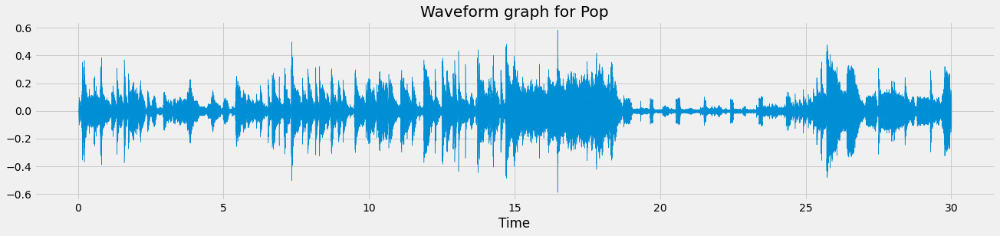

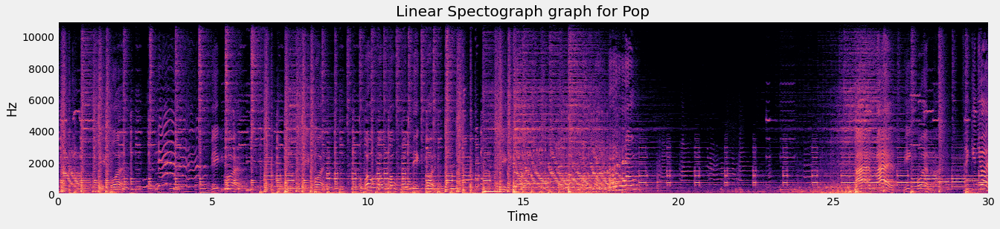

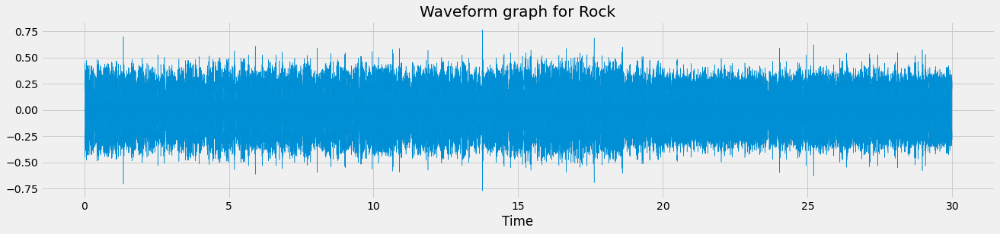

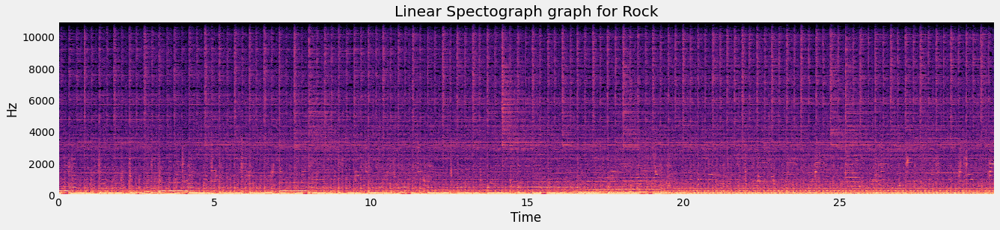

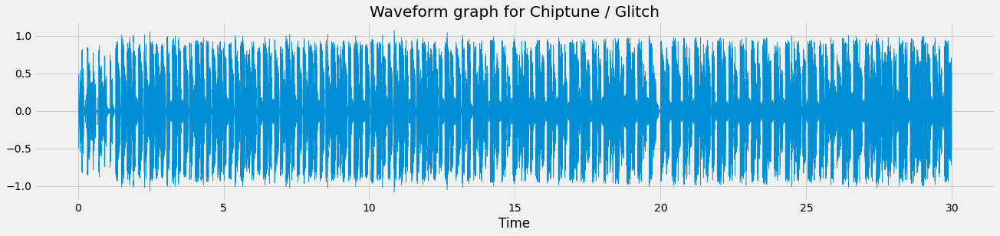

...

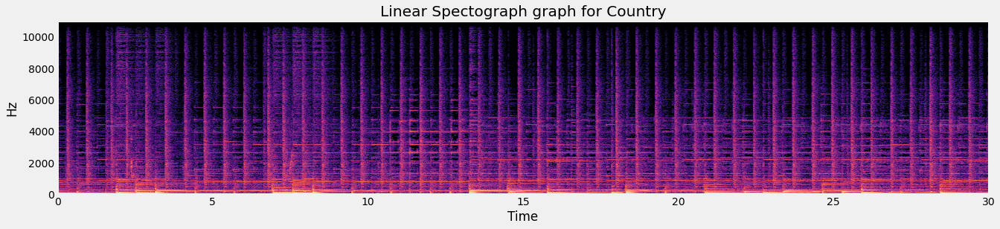

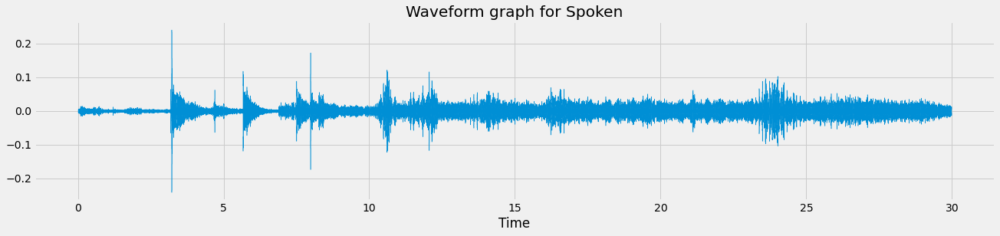

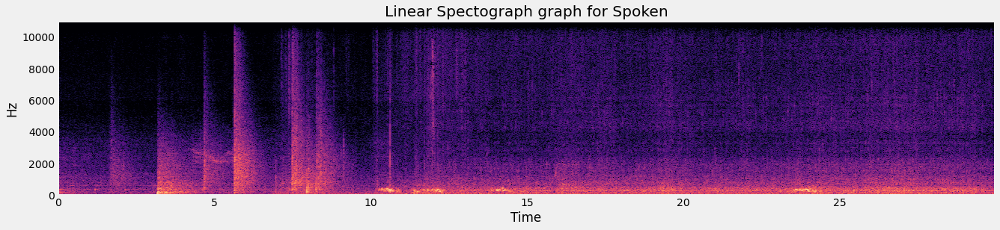

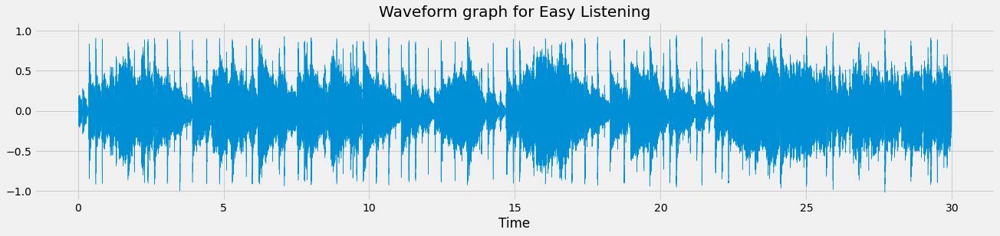

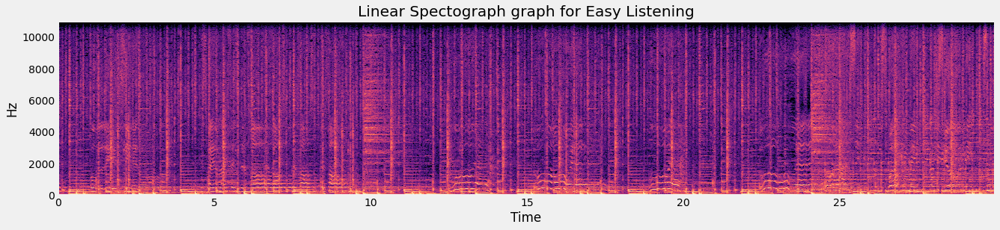

In [34]:
for gen in df.genre.unique():    
    y, sr = librosa.load(baseDir + df[df['genre'] == gen].sample(1, random_state = 33)['filepath'].values[0])
    D = librosa.amplitude_to_db(np.abs(librosa.stft(y)), ref=np.max)
    plt.figure(figsize =(20, 4))
    librosa.display.waveshow(y = y, sr = sr) 
    plt.title(f"Waveform graph for {gen}")
    plt.show()
    plt.figure(figsize =(20, 4))
    librosa.display.specshow(D, y_axis='linear', x_axis='time', sr=sr)
    plt.title(f"Linear Spectograph graph for {gen}")
    plt.show()



**As from this waveform graph we can see that different genre are quite distinct by have pattern repetition after set interval of time.**

In [ ]:
#check for beats per minute for each genre

bpm = []
for idx, row in tqdm(df.iterrows()):
    y,sr = librosa.load(baseDir + row['filepath'])
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
    id = row['song_id']
    bpm.append([id, tempo, beats])

298it [07:48,  1.56s/it]

In [ ]:
def features_extractor(file):
    audio, sample_rate = librosa.load(file, res_type='kaiser_fast') 
    mfccs_features = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=40)
    mfccs_scaled_features = np.mean(mfccs_features.T,axis=0)
    
    return mfccs_scaled_features

In [ ]:
mmfcs = []

for idx, row in tqdm(df.iterrows()):
    feature = features_extractor(baseDir + row['filepath'])
    label = row['genre_id']
    mmfcs.append([feature, label])

In [ ]:
df1 = pd.DataFrame(mmfcs, columns = ['features', 'genre'])

In [ ]:
df1['label'] = df.genre_id.values

In [ ]:
X=np.array(df1['features'].tolist())
y=np.array(df1['label'].tolist())

In [ ]:

y=to_categorical(y)

In [ ]:
y.shape

In [ ]:
X_train,X_test,y_train,y_test=train_test_split(X,y,test_size=0.2,random_state=0)

In [ ]:
model=Sequential()
###first layer
model.add(Dense(100,input_shape=(40,)))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###second layer
model.add(Dense(200))
model.add(Activation('relu'))
model.add(Dropout(0.5))
###third layer
model.add(Dense(100))
model.add(Activation('relu'))
model.add(Dropout(0.5))

###final layer
model.add(Dense(19))
model.add(Activation('softmax'))

In [ ]:
model.compile(loss='categorical_crossentropy',metrics=['accuracy'],optimizer='adam')

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint

num_epochs = 200
num_batch_size = 32

checkpointer = ModelCheckpoint(filepath='./music_pog.hdf5', 
                               verbose=1, save_best_only=True)


start = datetime.now()

model.fit(X_train, y_train, batch_size=num_batch_size, epochs=num_epochs, validation_data=(X_test, y_test), callbacks=[checkpointer], verbose=1)


duration = datetime.now() - start
print("Training completed in time: ", duration)

In [ ]:
test_accuracy=model.evaluate(X_test,y_test,verbose=0)
print(test_accuracy[1])

In [ ]:
for dirname, _, filenames in os.walk('../input/kaggle-pog-series-s01e02/test'):
    paths = [os.path.join(dirname, filename) for filename in filenames]
    id = [filename.split('.')[0] for filename in filenames]
    
df_test = pd.DataFrame({'song_id':id})

df_test.song_id = df_test.song_id.astype(int)

In [ ]:
test = df_test.merge(test, on = 'song_id')

In [ ]:
test_mmfcs = []
for idx, row in tqdm(test.iterrows()):
    feature = features_extractor(baseDir + row['filepath'])
    test_mmfcs.append(feature)

In [ ]:
test_input = np.array(test_mmfcs)
predicted_label=model.predict(test_input)
label = np.argmax(predicted_label,axis=1)

In [ ]:
label

In [ ]:
submission = pd.DataFrame({'song_id': test.song_id.values, 'genre_id': label})

In [ ]:
submission.to_csv('try1_0.csv')